In [1]:
import os
import numpy as np
import pandas as pd
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd

from scipy.signal import correlate
from scipy.stats import pearsonr, spearmanr, linregress
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import grangercausalitytests

import matplotlib.pyplot as plt
import seaborn as sns

# Define functions

# Function of loading and merging data

In [2]:
# Load and merge spatial data

def load_country_level_tweets(file_dir, file_name):
  gdf_countries = gpd.read_file(file_dir + file_name + '_country.geojson', driver='GeoJSON')
  return gdf_countries

def merge_country_level_tsgi(gdf_countries, df_tsgi_country_total):
  gdf_countries = gdf_countries.merge(df_tsgi_country_total, left_on='ADMIN', right_on='NAME_0', how='left')
  gdf_countries['tweets_proportion'] = gdf_countries['tweets_count'] / gdf_countries['N']
  gdf_countries['tweets_proportion_log'] = np.log(gdf_countries['tweets_proportion'])
  gdf_countries['score_difference'] = gdf_countries['score'] - gdf_countries['SCORE']
  return gdf_countries

## Function of plotting maps

In [3]:
def plot_maps(gdf, col, title, cmap='Blues'):

    fig, ax = plt.subplots(figsize=(50, 30), dpi=300)

    gdf.plot(column=col,
             cmap=cmap, 
             legend=True, 
             legend_kwds={'shrink': 0.5, 'aspect': 20, 'pad': 0.02},
             ax=ax)

    legend = ax.get_legend()
    if legend:
        legend.set_bbox_to_anchor((1, 0.5))
        legend.get_frame().set_linewidth(0.0)
        legend.get_frame().set_facecolor('none')
        legend.set_title('Proportion of Tweets with Blockchain', prop={'size': 25})
        for text in legend.get_texts():
            text.set_fontsize(30)

    ax.set_title(title, fontsize=35)

    plt.savefig('./figures/spatial/maps/' + title.lower().replace(' ', '_') + '.png', bbox_inches='tight')
    plt.show()


## Function of linear regression

In [247]:
def plot_linear_regression(var_pair, var_name_pair, title, if_normalized, ax=None):

    if ax is None:  # If no ax is provided, create a new figure and axis
        fig, ax = plt.subplots()

    x, y = var_pair[0], var_pair[1]

    if if_normalized == True:
      x = (x - np.min(x)) / (np.max(x) - np.min(x))
      y = (y - np.min(y)) / (np.max(y) - np.min(y))

    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    ax.scatter(x, y, label='Data points', color='lightgray', edgecolor='black', alpha=0.6)
    ax.plot(x, slope*x + intercept, 'black', label=f'Fit: y = {slope:.2f}x + {intercept:.2f}')

    legend_text = (
        f"Slope: {slope:.2f}\n"
        f"R-squared: {r_value**2:.2f}\n"
        f"P-value: {p_value:.4f}"
    )
    ax.legend([legend_text], fontsize=20, markerscale=0)
    legend = ax.get_legend()
    legend.get_frame().set_edgecolor('black')
    legend.get_frame().set_boxstyle("square")
    legend.get_frame().set_linewidth(0)

    if if_normalized == True:
      # ax.set_xlabel(var_name_pair[0]+'_normalized', fontsize=20)
      # ax.set_ylabel(var_name_pair[1]+'_normalized', fontsize=20)
      ax.set_xlabel(var_name_pair[0], fontsize=25)
      ax.set_ylabel(var_name_pair[1], fontsize=25)
    else:
      ax.set_xlabel(var_name_pair[0], fontsize=25)
      ax.set_ylabel(var_name_pair[1], fontsize=25)

    ax.set_title(title, fontsize=30)
    ax.grid(True)


def plot_linear_regression_grid(var_pairs, var_name_pairs, titles, if_normalized, cols_num=3, filename=None):
    # Calculate the number of rows and cols of the maps
    num_maps = len(var_pairs)
    rows = int(np.ceil(num_maps / cols_num))

    # Create subplots
    subplot_size = 10
    figsize = (cols_num * subplot_size, rows * subplot_size)
    fig, axs = plt.subplots(rows, cols_num, figsize=figsize)

    # If only one subplot, make axs a 2D array for iteration
    if num_maps == 1:
        axs = np.array([[axs]])

    # Iterate over each variable pair and plot on the corresponding ax
    for ax, var_pair, var_name_pair, title in zip(axs.ravel(), var_pairs, var_name_pairs, titles):
        plot_linear_regression(var_pair, var_name_pair, title, if_normalized, ax)

    # Hide any extra subplot axes
    for ax in axs.ravel()[num_maps:]:
        ax.axis('off')

    plt.tight_layout(pad=2, h_pad=5, w_pad=2)
    if filename != None:
       plt.savefig('./figures/spatial/linear/' + title.lower().replace(' ', '_') + '.png', bbox_inches='tight')
    plt.show()


# Load and merge data

## Load the dictionary

In [5]:
dictionary = pd.read_excel('./dictionary/dictionary.xlsx', sheet_name=None)

In [189]:
keywords = []
for key in dictionary.keys():
    new_keywords = dictionary[key]['Word'].tolist()
    new_keywords = [i.strip() for i in new_keywords]
    new_keywords = "|".join(new_keywords)
    new_keywords = new_keywords.split("|")
    keywords.extend(new_keywords)

keywords = list(set(keywords))
print(len(keywords))

152


In [193]:
negative_words = []

for key, value in dictionary.items():
  try:
    negative_word = value['Negative Word'].dropna().tolist()
    negative_word = [i.strip() for i in negative_word]
    negative_word = "|".join(negative_word)
    negative_word = negative_word.split("|")
    negative_words.extend(negative_word)
  except:
    pass

print(len(negative_words))
print(negative_words)

4
['Ethiopia', 'ripples', 'ripple effect', 'tethers']


## Load the aggregated tweets data

In [172]:
# Create a dict to store the aggregated tweets data for different topics, countries and time periods
df_tweets = {}

In [173]:
# Load the spatially aggregated tweets data (country-level)
file_dir = './data/tweets_aggregation/'

topics_options = {
    'All': list(dictionary.keys()),
    'Blockchain_NFT_Crypto': ['blockchain', 'NFT', 'crypto'],
    'Bitcoin': ['Bitcoin'],
    'Ethereum': ['Ethereum'], 
    'Binance': ['Binance'], 
    'Dogecoin': ['Dogecoin'], 
    'Ripple': ['Ripple'], 
    'Litecoin': ['Litecoin'], 
    'USDC': ['USDC'], 
    'Tether': ['Tether'], 
    'Cardano': ['Cardano'], 
    'Solana': ['Solana'], 
    'TRON': ['TRON']
}

for key in topics_options.keys():

  # Load the spatially aggregated tweets for each topic
  file_name = key.lower()
  gdf_topic = load_country_level_tweets(file_dir, file_name)
  gdf_topic = merge_country_level_tsgi(gdf_topic, df_tsgi_country_total)
  
  # Save the data to the dict
  df_tweets[key] = {}
  df_tweets[key]['country'] = gdf_topic

## Load the TSGI data

In [6]:
tsgi_world = './data/tsgi/tsgi_world.csv'
tsgi_country = './data/tsgi/tsgi_country.csv'

df_tsgi_world = pd.read_csv(tsgi_world)
df_tsgi_country = pd.read_csv(tsgi_country)

df_tsgi_world['DATE'] = pd.to_datetime(df_tsgi_world['DATE'])
df_tsgi_world.set_index('DATE', inplace=True)
df_tsgi_world = df_tsgi_world.sort_values(by='DATE')

df_tsgi_country['DATE'] = pd.to_datetime(df_tsgi_country['DATE'])
df_tsgi_country.set_index('DATE', inplace=True)
df_tsgi_country = df_tsgi_country.sort_values(by='DATE')
df_tsgi_country.loc[df_tsgi_country['NAME_0'] == 'United States', 'NAME_0'] = 'United States of America'  # Modify the country name to match data

df_tsgi_world = df_tsgi_world.dropna()  # world-level daily data
df_tsgi_country = df_tsgi_country.dropna()  # country-level daily data

df_tsgi_world_monthly = df_tsgi_world.resample('M').agg({'N': 'sum', 'SCORE': 'mean'})  # world-level monthly data
df_tsgi_country_monthly = df_tsgi_country.resample('M').agg({'N': 'sum', 'SCORE': 'mean'})  # country-level monthly data
df_tsgi_country_total = df_tsgi_country.groupby('NAME_0').agg({'N': 'sum', 'SCORE': 'mean'}).reset_index()  # country-level total data

## Load the crypto price data

In [7]:
crypto_dir = './data/crypto_price/'
files = os.listdir(crypto_dir)

df_cryptos = {}   # daily crypto price

for file in files:
  df_crypto = pd.read_csv(os.path.join(crypto_dir, file))
  ## Set timestamp (timeClose) as index
  df_crypto['timestamp'] = pd.to_datetime(df_crypto['timestamp']).dt.date
  df_crypto.set_index('timestamp', inplace=True)
  df_crypto.index = pd.to_datetime(df_crypto.index)
  crypto_name = file.split('_')[0]
  df_cryptos[crypto_name] = df_crypto

## Sort df_cryptos
df_cryptos = {key: df_cryptos[key] for key in sorted(df_cryptos.keys(), key=lambda k: df_cryptos[k].index.min())}
## Rename columns in df_cryptos
for key in df_cryptos.keys():
  df_cryptos[key].columns = [key + '_' + i for i in df_cryptos[key].columns]

df_cryptos_monthly = {}   # monthly crypto price

for key in df_cryptos:
  df_crypto = df_cryptos[key]
  df_crypto.index = pd.to_datetime(df_crypto.index)
  df_monthly = df_crypto.resample('M').mean(numeric_only=True)
  df_cryptos_monthly[key] = df_monthly
## Load the aggregated tweets data

## Load the GDP per capita data

In [182]:
# Load data
'''Data source: World Development Indicators
   Last Updated Date: 2023-10-26
'''
df_gdp_pcap = pd.read_csv('./data/gdp_pcap/gdp_pcap_worldbank.csv')
df_gdp_pcap.set_index('Country Code', inplace=True)

# Calculate the average GDP per capita from 2013 to 2022
df_gdp_pcap['2012_2022_gdp_pcap'] = df_gdp_pcap.iloc[:, 56:67].mean(axis=1)

# Merge the average GDP per capita to the country-level tweets data
for key in df_tweets.keys():
  df_tweets[key]['country'] = df_tweets[key]['country'].merge(df_gdp_pcap['2012_2022_gdp_pcap'], left_on='ISO_A3', right_on='Country Code', how='left')
  df_tweets[key]['country']['2012_2022_gdp_pcap_log'] = np.log(df_tweets[key]['country']['2012_2022_gdp_pcap'])

## Load the ban policy data

In [175]:
# Load data
df_ban = pd.read_csv('./data/crypto_ban/crypto_ban_country.csv')
df_ban.drop(columns=['ADMIN'], inplace=True)

# Merge data to the country-level tweets data
for key in df_tweets.keys():
  df_tweets[key]['country'] = df_tweets[key]['country'].merge(df_ban, left_on='ISO_A3', right_on='ISO_A3', how='left')


# Spatial analysis

## Plot maps

In [ ]:
# Plot maps of proportions of tweets
for key in df_tweets.keys():
    gdf_topic_country = df_tweets[key]['country']

    title =  'Proportion of tweets with ' + key.lower()
    plot_maps(gdf_topic, 'tweets_proportion_log', title, cmap='Purples')

In [12]:
# Plot maps of sentiment scores
for key in df_tweets.keys():
    gdf_topic_country = df_tweets[key]['country']

    title =  'Sentiment score of tweets with ' + key.lower()
    plot_maps(gdf_topic, 'score', title, cmap='viridis')

## Linear regression

### Proportion of tweets and sentiment score

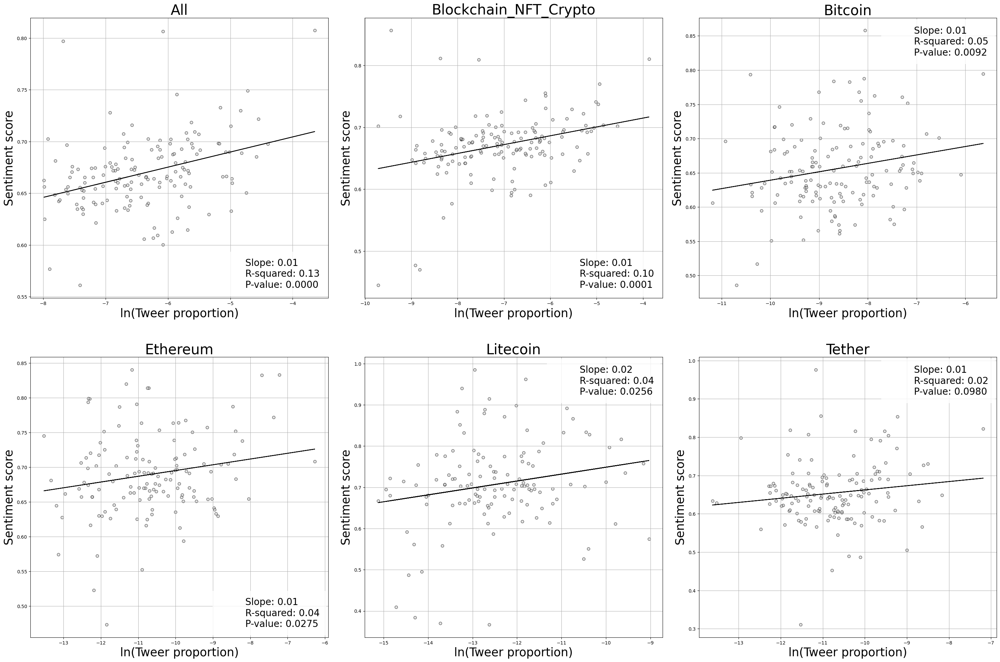

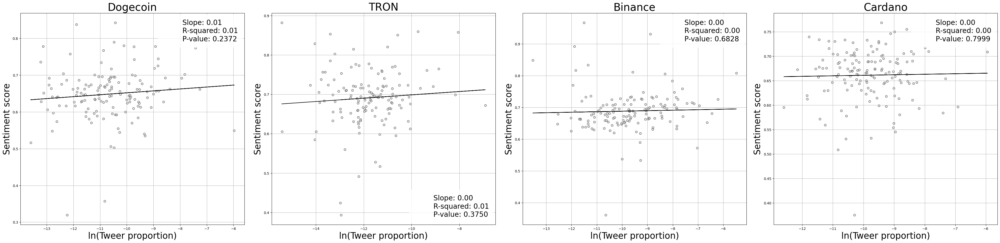

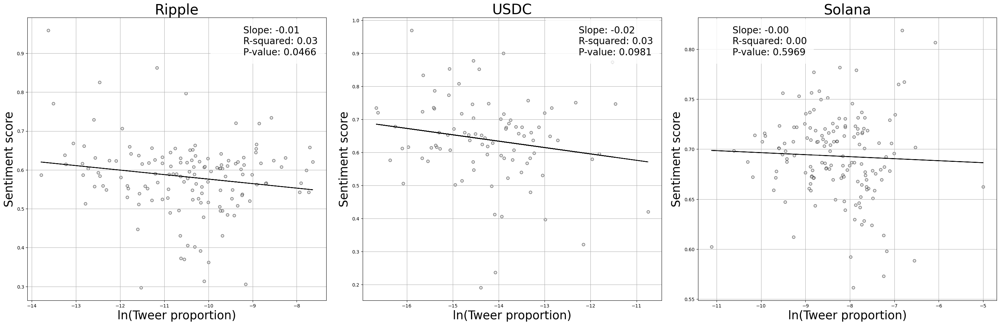

In [237]:
topics_combos = [['All', 'Blockchain_NFT_Crypto', 'Bitcoin', 'Ethereum', 'Litecoin', 'Tether'],
                 ['Dogecoin', 'TRON', 'Binance', 'Cardano'],
                 ['Ripple', 'USDC', 'Solana']]
cols_num_combos = [3, 4, 3]

col_x, col_y = 'tweets_proportion_log', 'score'
label_x, label_y = 'ln(Tweer proportion)', 'Sentiment score'

for i, topics in enumerate(topics_combos):
    cols_num = cols_num_combos[i]
    var_name_pairs = [[label_x, label_y]] * len(topics)
    var_pairs = []
    for topic in topics:
        gdf_topic_country = df_tweets[topic]['country']
        gdf_topic_country = gdf_topic_country.dropna(subset=[col_x, col_y])
        var_pairs.append([gdf_topic_country[col_x], gdf_topic_country[col_y]])

    plot_linear_regression_grid(var_pairs, var_name_pairs, topics, if_normalized=False, cols_num=cols_num)

### GDP and proportion of tweets

Bitcoin


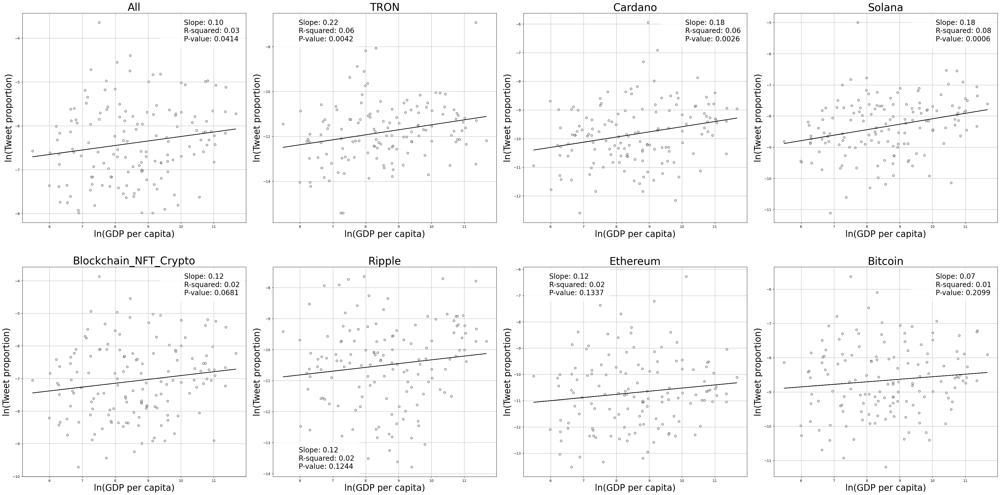

Tether


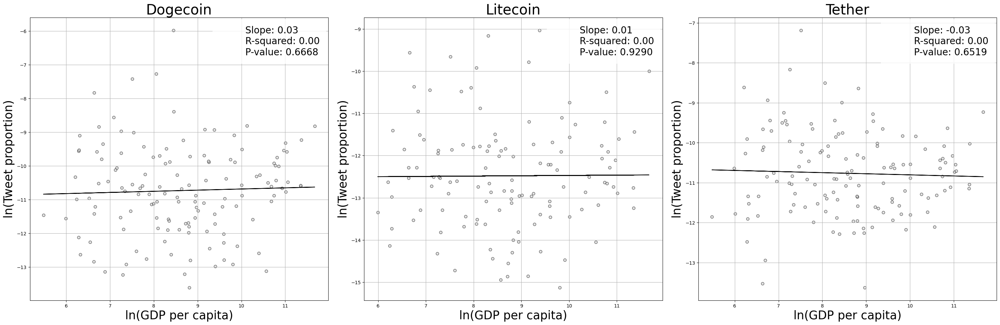

USDC


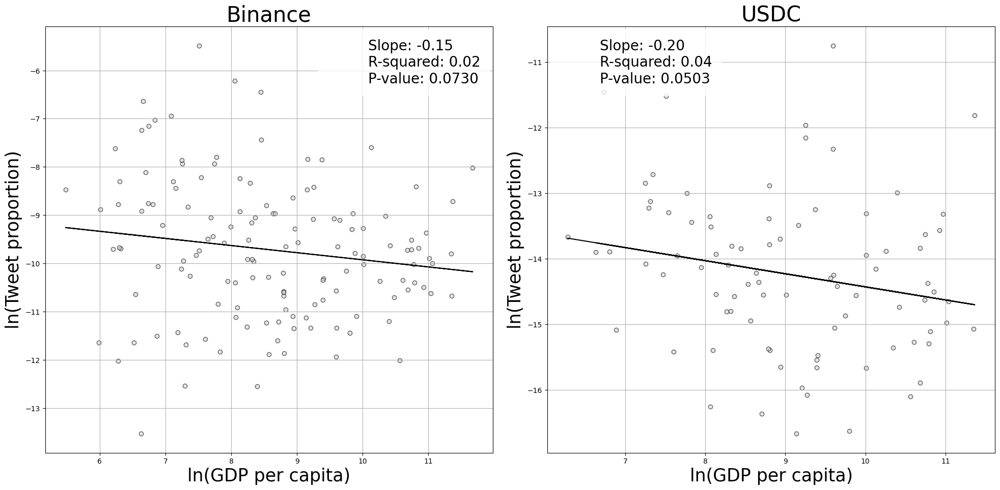

In [248]:
topics_combos = {'positive':['All', 'TRON', 'Cardano', 'Solana', 'Blockchain_NFT_Crypto', 'Ripple', 'Ethereum', 'Bitcoin'],
                 'neutral':['Dogecoin', 'Litecoin', 'Tether'],
                 'negative':['Binance', 'USDC']}
cols_num_combos = [4, 3, 2]

col_x, col_y = '2012_2022_gdp_pcap_log', 'tweets_proportion_log'
label_x, label_y = 'ln(GDP per capita)', 'ln(Tweet proportion)' 

for i in range(len(topics_combos.keys())):
    type = list(topics_combos.keys())[i]
    topics = topics_combos[type]
    cols_num = cols_num_combos[i]
    var_name_pairs = [[label_x, label_y]] * len(topics)
    var_pairs = []
    for topic in topics:
        gdf_topic_country = df_tweets[topic]['country']
        gdf_topic_country = gdf_topic_country.dropna(subset=[col_x, col_y])
        var_pairs.append([gdf_topic_country[col_x], gdf_topic_country[col_y]])

    filename = 'linear_regression_' + type
    plot_linear_regression_grid(var_pairs, var_name_pairs, topics, if_normalized=False, cols_num=cols_num, filename=filename)
    

### GDP and sentiment score

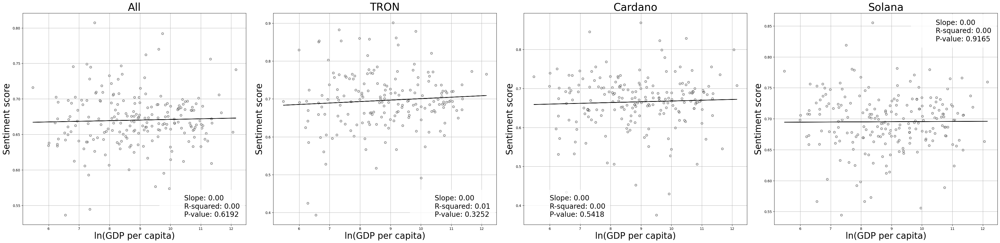

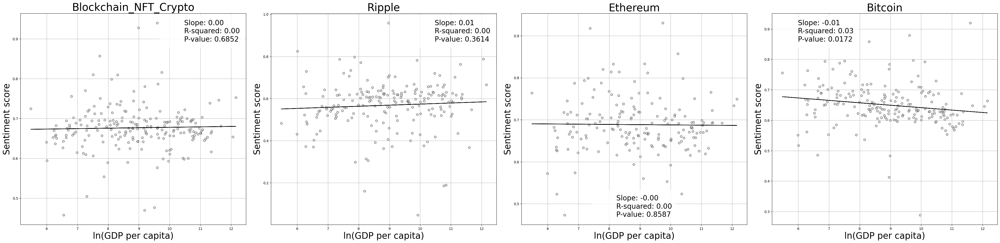

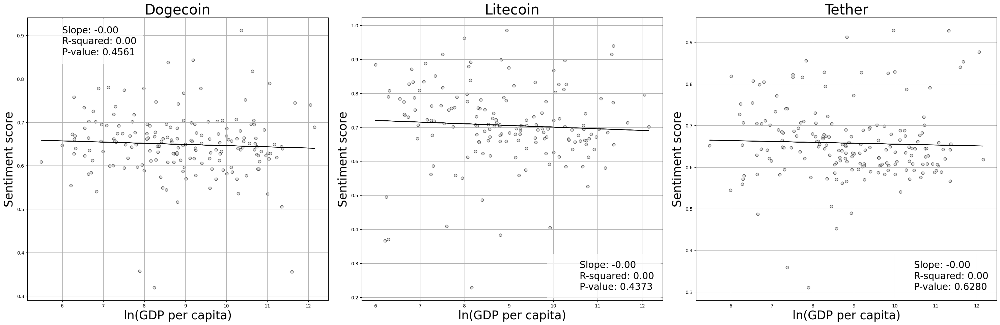

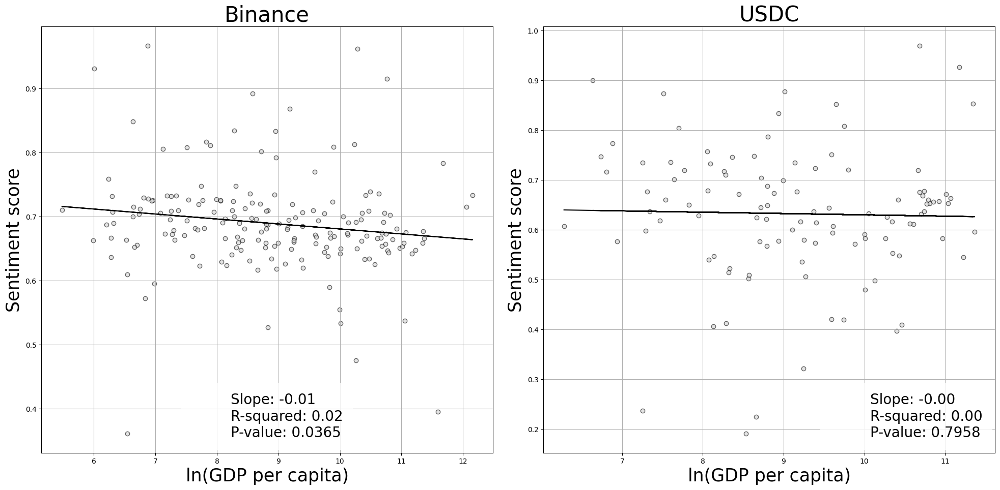

In [239]:
topics_combos = [['All', 'TRON', 'Cardano', 'Solana'],
                 ['Blockchain_NFT_Crypto', 'Ripple', 'Ethereum', 'Bitcoin'],
                 ['Dogecoin', 'Litecoin', 'Tether'],
                 ['Binance', 'USDC']]
cols_num_combos = [4, 4, 3, 2]

col_x, col_y = '2012_2022_gdp_pcap_log', 'score'
label_x, label_y = 'ln(GDP per capita)', 'Sentiment score' 

for i, topics in enumerate(topics_combos):
    cols_num = cols_num_combos[i]
    var_name_pairs = [[label_x, label_y]] * len(topics)
    var_pairs = []
    for topic in topics:
        gdf_topic_country = df_tweets[topic]['country']
        gdf_topic_country = gdf_topic_country.dropna(subset=[col_x, col_y])
        var_pairs.append([gdf_topic_country[col_x], gdf_topic_country[col_y]])

    plot_linear_regression_grid(var_pairs, var_name_pairs, topics, if_normalized=False, cols_num=cols_num)
    

## Scatter Plots with 3 variables

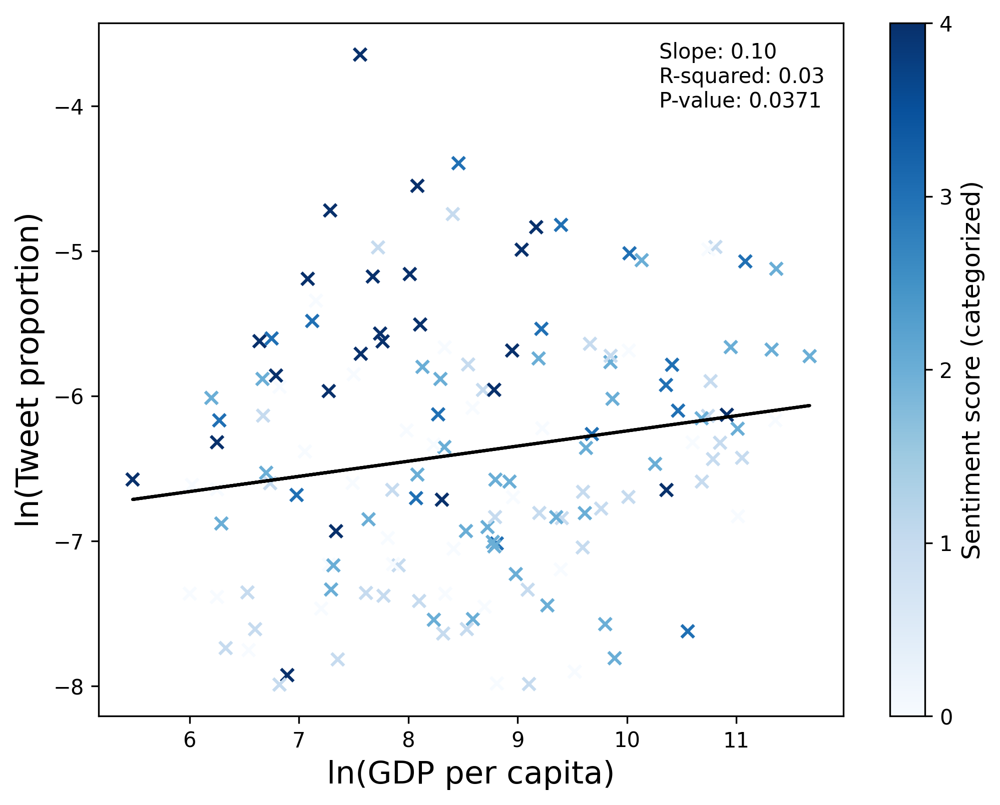

In [229]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

df = df_tweets['All']['country'].copy()
col_x, col_y, col_z = '2013_2022_gdp_pcap_log', 'tweets_proportion_log', 'score'
label_x, label_y, label_z = 'ln(GDP per capita)', 'ln(Tweet proportion)', 'Sentiment score (categorized)'

category_num = 5
df['category'] = pd.qcut(df[col_z], category_num, labels=False)

plt.figure(figsize=(8, 6), dpi=300)
scatter = plt.scatter(df[col_x], df[col_y], c=df['category'], cmap='Blues', marker='x', label='Countries')

df.dropna(subset=[col_x, col_y], inplace=True)
x, y = df[col_x], df[col_y]
slope, intercept, r_value, p_value, std_err = linregress(x, y)
plt.plot(x, slope*x + intercept, 'black', label=f'Fit: y = {slope:.2f}x + {intercept:.2f}')

legend_text = (
    f"Slope: {slope:.2f}\n"
    f"R-squared: {r_value**2:.2f}\n"
    f"P-value: {p_value:.4f}"
)
plt.legend([legend_text], fontsize=10, markerscale=0)
legend = plt.gca().get_legend()
legend.get_frame().set_edgecolor('black')
legend.get_frame().set_boxstyle("square")
legend.get_frame().set_linewidth(0)

cbar = plt.colorbar(scatter, ticks=range(category_num))
cbar.ax.set_ylabel(label_z, size=12)

plt.xlabel(label_x, fontsize=15)
plt.ylabel(label_y, fontsize=15)
plt.title('')
plt.savefig('./figures/spatial/scatter/scatter_all.png', bbox_inches='tight')
plt.show()


## OLS regression model

### GDP, Proportion of Tweet

In [183]:
df = df_tweets['All']['country'].copy()
dependent_var = 'score'
independent_vars = ['2012_2022_gdp_pcap_log', 'tweets_proportion_log']

df.dropna(subset=[dependent_var] + independent_vars, inplace=True)

# Define the independent variable(s) (X) and the dependent variable (y)
X = df[independent_vars]
y = df[dependent_var]

# Add a constant term to the independent variable(s)
X = sm.add_constant(X)

# Create the OLS model
model = sm.OLS(y, X)

# Fit the model to the data
results = model.fit()

# Print the summary of the regression results
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                  score   R-squared:                       0.200
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     17.75
Date:                Wed, 22 Nov 2023   Prob (F-statistic):           1.32e-07
Time:                        19:33:51   Log-Likelihood:                 310.69
No. Observations:                 145   AIC:                            -615.4
Df Residuals:                     142   BIC:                            -606.5
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0

### GDP, Proportion of Tweet, Ban

In [184]:
df = df_tweets['All']['country'].copy()
dependent_var = 'score'
independent_vars = ['2012_2022_gdp_pcap_log', 'tweets_proportion_log', 'ban_status_binary']

df.dropna(subset=[dependent_var] + independent_vars, inplace=True)

# Define the independent variable(s) (X) and the dependent variable (y)
X = df[independent_vars]
y = df[dependent_var]

# Add a constant term to the independent variable(s)
X = sm.add_constant(X)

# Create the OLS model
model = sm.OLS(y, X)

# Fit the model to the data
results = model.fit()

# Print the summary of the regression results
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                  score   R-squared:                       0.346
Model:                            OLS   Adj. R-squared:                  0.306
Method:                 Least Squares   F-statistic:                     8.644
Date:                Wed, 22 Nov 2023   Prob (F-statistic):           0.000104
Time:                        19:34:06   Log-Likelihood:                 119.76
No. Observations:                  53   AIC:                            -231.5
Df Residuals:                      49   BIC:                            -223.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      0